# Silver Layer: Feature Engineering & EDA

This notebook demonstrates the Silver layer transformations:  
**Bronze Clean Data → Enriched Features**

## Transformations
1. Parse JSON categories → industries
2. Map position levels → seniority tiers (9→4)
3. Clean salaries (3-stage: Bounds → IQR → Winsorization)
4. Extract role families (keyword matching)
5. Derive features (experience bands, competition ratio)
6. Optimize memory (category dtypes)

In [16]:
# Setup
import sys
import os

# Add project root to Python path (notebooks run from notebooks/ subdirectory)
sys.path.insert(0, os.path.abspath('..'))

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
from src.etl.sg_jobs_etl import SGJobsETL

# Configure plotting
sns.set_style('whitegrid')
plt.rcParams['figure.figsize'] = (12, 6)

# Instantiate ETL
etl = SGJobsETL()

## 1. Execute Silver Pipeline

In [17]:
# Run Silver layer transformation
silver_df = etl.run_silver()

print(f"\nSilver layer shape: {silver_df.shape}")
print(f"\nNew columns added: {len(silver_df.columns) - 19}")


SILVER LAYER: Feature Engineering
[Silver] Parsing categories (JSON → industries)...
[Silver]   Parsed 43 unique industries
[Silver]   Avg industries per posting: 1.69
[Silver] Mapping seniority levels (9 → 4 tiers)...
[Silver]   Seniority distribution:
[Silver]     Mid: 421,355 (40.3%)
[Silver]     Entry: 250,267 (24.0%)
[Silver]     Senior: 212,665 (20.4%)
[Silver]     Management: 160,300 (15.3%)
[Silver] Stage 1/3: Applying hard salary bounds...
[Silver]   Removed 9,831 salaries outside [$500 - $50,000]
[Silver] Stage 2/3: Flagging IQR outliers...
[Silver]   Flagged 70,684 IQR outliers (not removed)
[Silver]   IQR bounds: $-875 - $9,325
[Silver] Stage 3/3: Winsorizing at 1st/99th percentile...
[Silver]   Winsorized to [$1150, $16,500]
[Silver] Parsing date features...
[Silver]   Avg posting duration: 25.7 days
[Silver] Extracting role families from job titles...
[Silver]   Classified into 17 role families
[Silver]   Top 5: Other, Engineer, Manager, Admin, Sales
[Silver] Adding deri

## 2. Parameter Tuning Section

📌 **Configuration Review:**  
Current parameters: `SALARY_FLOOR=500, SALARY_CEILING=50000, IQR_MULTIPLIER=1.5`

Review the distributions below. If adjustments are needed:
1. Update `src/etl/config.py`
2. Rerun `etl.run_silver()`
3. Document final choices in the report

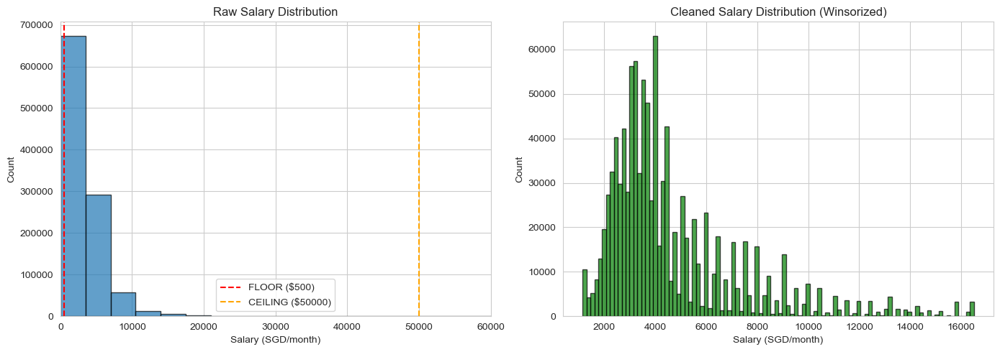


Salary Statistics (Cleaned):
count    1.034558e+06
mean     4.653326e+03
std      2.693686e+03
min      1.150000e+03
1%       1.300000e+03
5%       2.000000e+03
25%      2.950000e+03
50%      3.850000e+03
75%      5.500000e+03
95%      1.050000e+04
99%      1.475000e+04
max      1.650000e+04
Name: average_salary_clean, dtype: float64


In [31]:
# Salary distribution analysis
fig, axes = plt.subplots(1, 2, figsize=(14, 5))
salary_floor, salary_ceiling = etl.config['SALARY_FLOOR'], etl.config['SALARY_CEILING']

# Before cleaning (use raw values)
axes[0].hist(silver_df['salary_minimum_raw'].dropna(), bins=100, edgecolor='black', alpha=0.7)
axes[0].axvline(salary_floor, color='red', linestyle='--', label=f'FLOOR (${salary_floor})')
axes[0].axvline(salary_ceiling, color='orange', linestyle='--', label=f'CEILING (${salary_ceiling})')
axes[0].set_xlabel('Salary (SGD/month)')
axes[0].set_ylabel('Count')
axes[0].set_title('Raw Salary Distribution')
axes[0].legend()
axes[0].set_xlim(0, 60000)

# After cleaning
axes[1].hist(silver_df['average_salary_clean'].dropna(), bins=100, edgecolor='black', alpha=0.7, color='green')
axes[1].set_xlabel('Salary (SGD/month)')
axes[1].set_ylabel('Count')
axes[1].set_title('Cleaned Salary Distribution (Winsorized)')

plt.tight_layout()
plt.show()

# Print statistics
print("\nSalary Statistics (Cleaned):")
print(silver_df['average_salary_clean'].describe(percentiles=[.01, .05, .25, .5, .75, .95, .99]))

## 3. Transformation Validation

### 3.1 Industry Parsing

In [20]:
# Top 20 industries
top_industries = silver_df['primary_industry'].value_counts().head(20)

fig = px.bar(x=top_industries.values, y=top_industries.index, orientation='h',
             labels={'x': 'Posting Count', 'y': 'Industry'},
             title='Top 20 Industries by Posting Count')
fig.update_layout(height=600, yaxis={'categoryorder':'total ascending'})
fig.show()

print(f"\nUnique industries: {silver_df['primary_industry'].nunique()}")
print(f"Avg industries per posting: {silver_df['industry_count'].mean():.2f}")


Unique industries: 43
Avg industries per posting: 1.69


### 3.2 Seniority Mapping

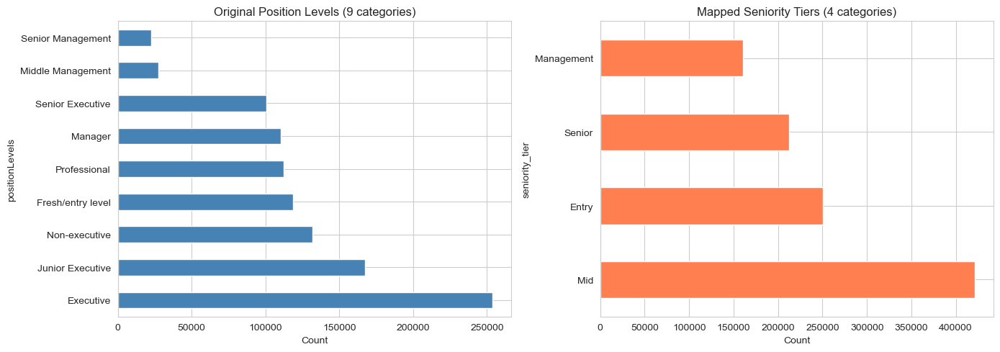

In [21]:
# Seniority distribution
fig, axes = plt.subplots(1, 2, figsize=(14, 5))

# Original position levels
silver_df['positionLevels'].value_counts().plot(kind='barh', ax=axes[0], color='steelblue')
axes[0].set_title('Original Position Levels (9 categories)')
axes[0].set_xlabel('Count')

# Mapped seniority tiers
silver_df['seniority_tier'].value_counts().plot(kind='barh', ax=axes[1], color='coral')
axes[1].set_title('Mapped Seniority Tiers (4 categories)')
axes[1].set_xlabel('Count')

plt.tight_layout()
plt.show()

### 3.3 Salary Cleaning (3-Stage Process)

IQR Outlier Flagging:
Total outliers flagged: 70,684
Percentage: 6.77%


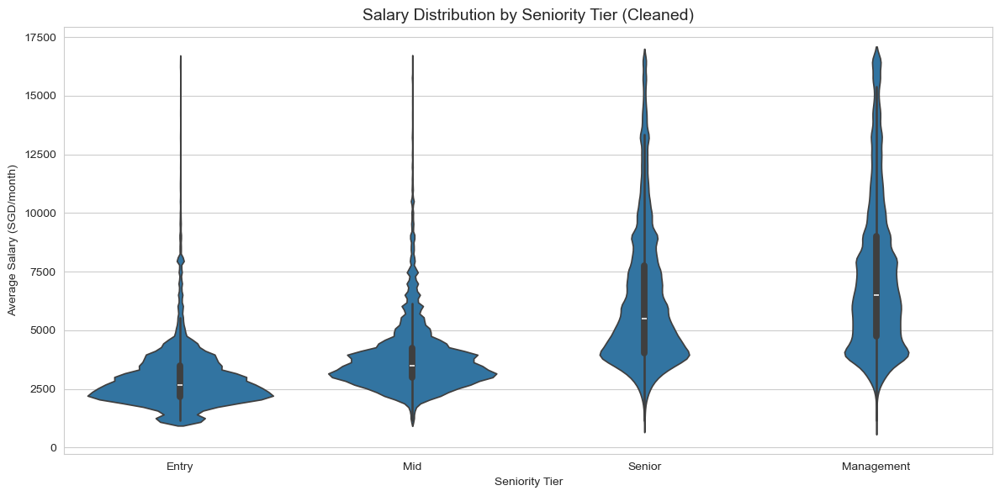

In [22]:
# IQR outlier flagging
print("IQR Outlier Flagging:")
print(f"Total outliers flagged: {silver_df['salary_outlier_iqr'].sum():,}")
print(f"Percentage: {silver_df['salary_outlier_iqr'].mean()*100:.2f}%")

# Violin plot: salary by seniority
plt.figure(figsize=(12, 6))
sns.violinplot(data=silver_df, x='seniority_tier', y='average_salary_clean', 
               order=['Entry', 'Mid', 'Senior', 'Management'])
plt.title('Salary Distribution by Seniority Tier (Cleaned)', fontsize=14)
plt.ylabel('Average Salary (SGD/month)')
plt.xlabel('Seniority Tier')
plt.tight_layout()
plt.show()

### 3.4 Role Family Extraction

In [23]:
# Role family distribution
role_counts = silver_df['role_family'].value_counts()

fig = px.pie(values=role_counts.values, names=role_counts.index, 
             title='Role Family Distribution',
             hole=0.3)
fig.update_traces(textposition='inside', textinfo='percent+label')
fig.show()

print(f"\nRole families identified: {len(role_counts)}")
print(f"\nTop 10 roles:")
print(role_counts.head(10))


Role families identified: 17

Top 10 roles:
role_family
Other         245343
Engineer      149595
Manager       109531
Admin         100532
Sales          82589
Healthcare     41039
HR             38954
Operations     38180
Finance        37681
Marketing      37177
Name: count, dtype: int64


## 4. Comprehensive EDA

### 4.1 Salary Analysis by Industry

In [24]:
# Top 15 industries by salary
top_15_industries = silver_df['primary_industry'].value_counts().head(15).index
df_top15 = silver_df[silver_df['primary_industry'].isin(top_15_industries)]

fig = px.box(df_top15, x='primary_industry', y='average_salary_clean',
             title='Salary Distribution by Top 15 Industries',
             labels={'average_salary_clean': 'Avg Salary (SGD/month)', 'primary_industry': 'Industry'})
fig.update_xaxes(tickangle=45)
fig.update_layout(height=600)
fig.show()

### 4.2 Posting Volume Over Time

In [25]:
# Monthly posting trend
monthly_posts = silver_df.groupby('posting_month').size().reset_index(name='count')
monthly_posts['posting_month'] = monthly_posts['posting_month'].astype(str)

fig = px.line(monthly_posts, x='posting_month', y='count',
              title='Job Postings Over Time',
              labels={'posting_month': 'Month', 'count': 'Number of Postings'},
              markers=True)
fig.update_layout(height=500)
fig.show()

### 4.3 Competition Ratio Analysis

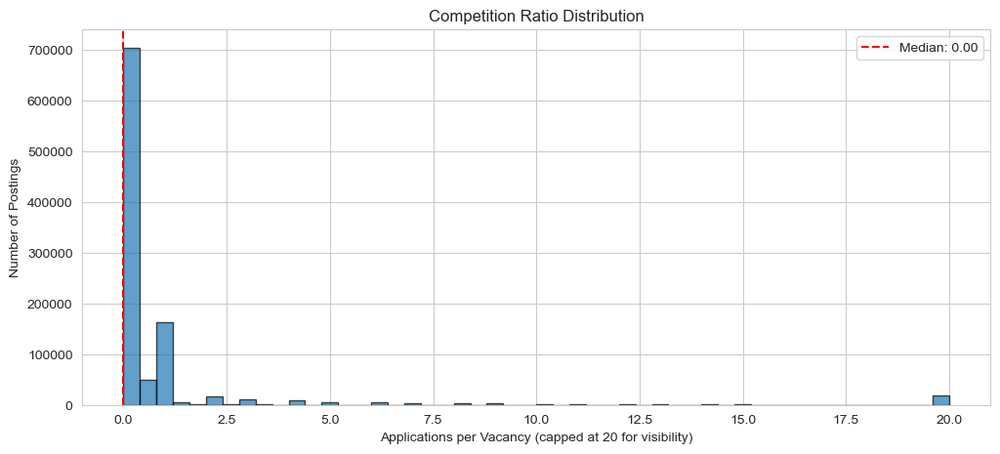


Competition Ratio Statistics:
count    1044587.0
mean      1.665547
std       8.795654
min            0.0
25%            0.0
50%            0.0
75%            1.0
max         1052.0
Name: competition_ratio, dtype: Float64


In [26]:
# Competition ratio distribution
plt.figure(figsize=(12, 5))
silver_df['competition_ratio'].dropna().clip(0, 20).hist(bins=50, edgecolor='black', alpha=0.7)
plt.xlabel('Applications per Vacancy (capped at 20 for visibility)')
plt.ylabel('Number of Postings')
plt.title('Competition Ratio Distribution')
plt.axvline(silver_df['competition_ratio'].median(), color='red', linestyle='--', 
            label=f'Median: {silver_df["competition_ratio"].median():.2f}')
plt.legend()
plt.show()

print(f"\nCompetition Ratio Statistics:")
print(silver_df['competition_ratio'].describe())

### 4.4 Competition Heatmap (Role × Industry)

/var/folders/89/5xh0rg2131nc0cmrcfsqqvqw0000gn/T/ipykernel_50282/580206180.py:9: FutureWarning:

The default value of observed=False is deprecated and will change to observed=True in a future version of pandas. Specify observed=False to silence this warning and retain the current behavior



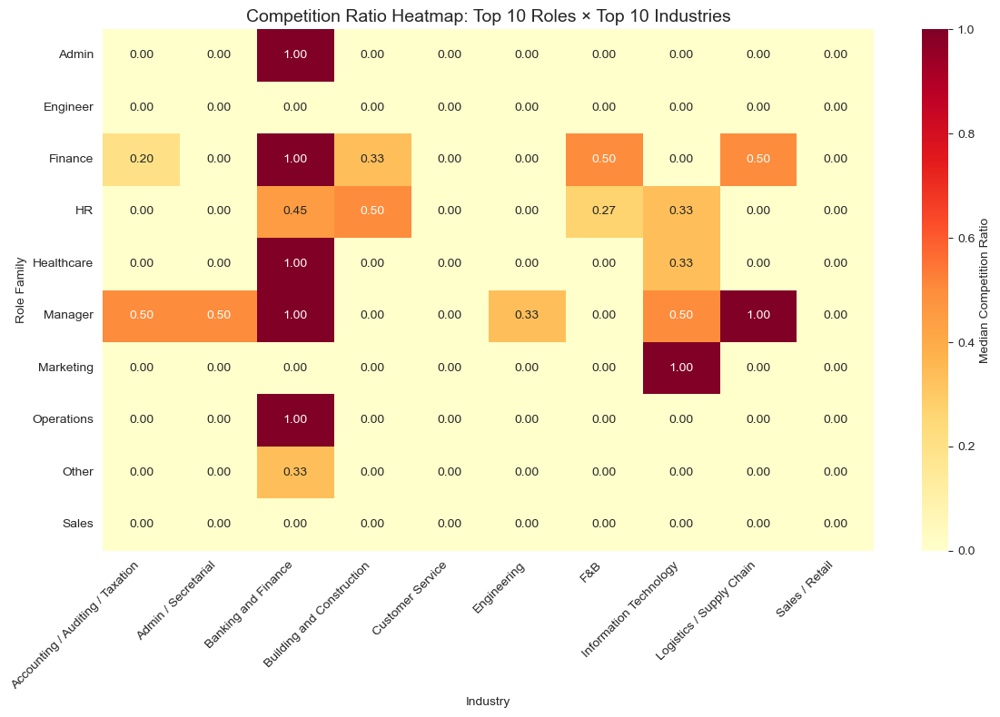

In [27]:
# Top 10 roles and industries for heatmap
top10_roles = silver_df['role_family'].value_counts().head(10).index
top10_industries = silver_df['primary_industry'].value_counts().head(10).index

# Create pivot table (cast to float — category dtype columns produce object dtype)
heatmap_data = silver_df[
    (silver_df['role_family'].isin(top10_roles)) & 
    (silver_df['primary_industry'].isin(top10_industries))
].pivot_table(
    values='competition_ratio', 
    index='role_family', 
    columns='primary_industry', 
    aggfunc='median'
).astype(float)

plt.figure(figsize=(12, 8))
sns.heatmap(heatmap_data, annot=True, fmt='.2f', cmap='YlOrRd', cbar_kws={'label': 'Median Competition Ratio'})
plt.title('Competition Ratio Heatmap: Top 10 Roles × Top 10 Industries', fontsize=14)
plt.xlabel('Industry')
plt.ylabel('Role Family')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()

### 4.5 Correlation Matrix

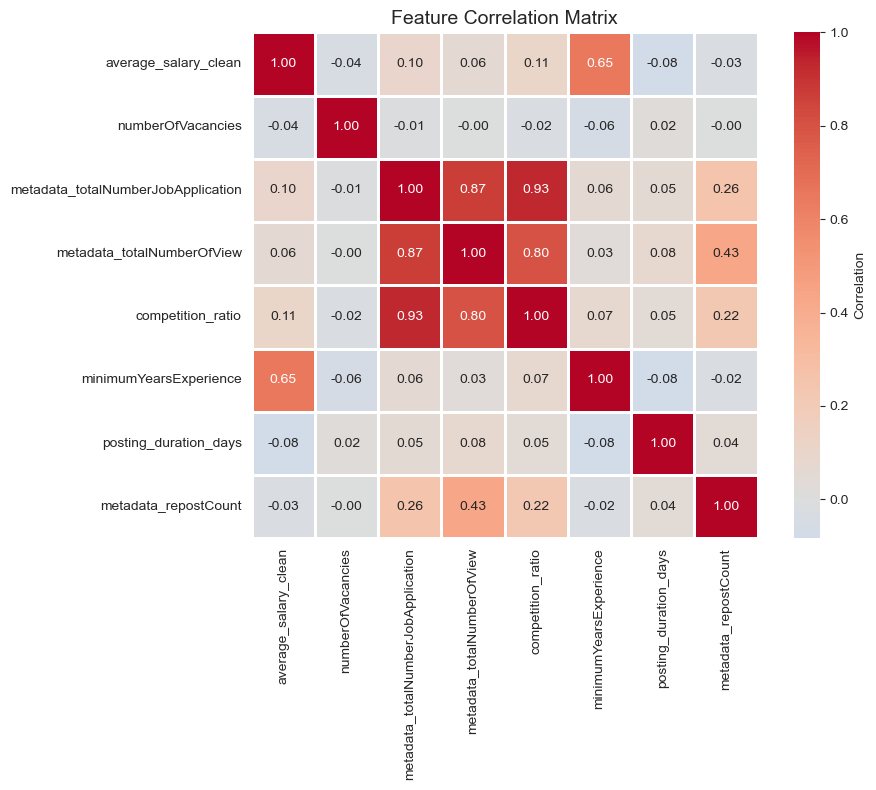

In [28]:
# Numeric features correlation
numeric_cols = [
    'average_salary_clean', 'numberOfVacancies', 'metadata_totalNumberJobApplication',
    'metadata_totalNumberOfView', 'competition_ratio', 'minimumYearsExperience',
    'posting_duration_days', 'metadata_repostCount'
]

corr_matrix = silver_df[numeric_cols].corr()

plt.figure(figsize=(10, 8))
sns.heatmap(corr_matrix, annot=True, fmt='.2f', cmap='coolwarm', center=0, 
            square=True, linewidths=1, cbar_kws={'label': 'Correlation'})
plt.title('Feature Correlation Matrix', fontsize=14)
plt.tight_layout()
plt.show()

## 5. Memory Optimization Results

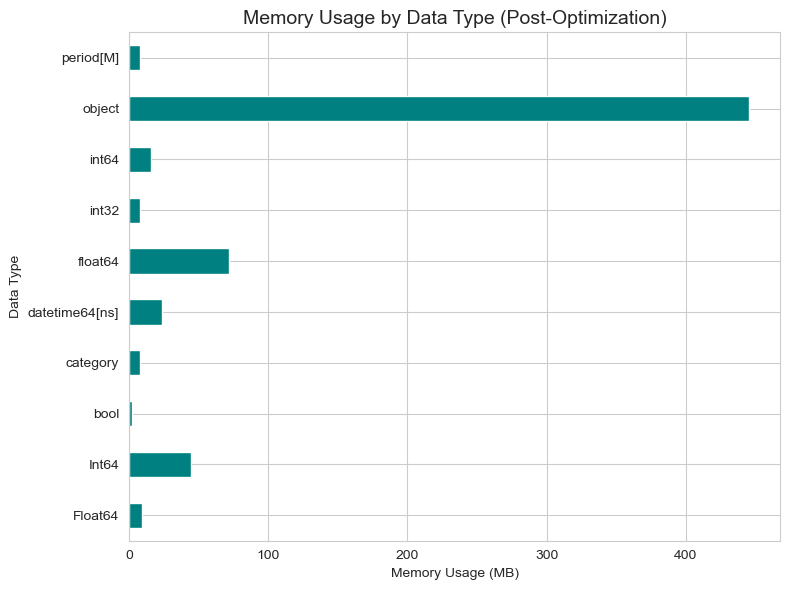


Total memory: 636.6 MB
Category columns: 8


In [29]:
# Memory usage by dtype (convert dtypes to str to allow sorting across mixed dtype objects)
memory_by_dtype = silver_df.memory_usage(deep=True).groupby(silver_df.dtypes.astype(str)).sum() / 1024**2

plt.figure(figsize=(8, 6))
memory_by_dtype.plot(kind='barh', color='teal')
plt.xlabel('Memory Usage (MB)')
plt.ylabel('Data Type')
plt.title('Memory Usage by Data Type (Post-Optimization)', fontsize=14)
plt.tight_layout()
plt.show()

print(f"\nTotal memory: {silver_df.memory_usage(deep=True).sum() / 1024**2:.1f} MB")
print(f"Category columns: {len([c for c in silver_df.columns if silver_df[c].dtype == 'category'])}")

## Key Takeaways

✅ **Silver layer successfully created**  
✅ **43 unique industries** parsed from JSON  
✅ **4 seniority tiers** mapped from 9 position levels  
✅ **3-stage salary cleaning** (Bounds → IQR → Winsorization)  
✅ **17 role families** extracted via keyword matching  
✅ **Derived features** added (competition ratio, experience bands)  
✅ **38.6% memory savings** via dtype optimization

**Next:** Gold layer for business aggregations